# ***Linear Regression***

## ***Universidad Central***

## ***Maestría en analítica de datos***

## ***Métodos estadísticos para analítica de datos.***
## ***Docente: Luis Andrés Campos Maldonado.***

In [1]:
import folium
import warnings
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
import plotly.express as px
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split            # Train, Test sets
from sklearn.metrics import mean_absolute_error, r2_score       # Para obtener las métricas de evaluación.
from sklearn.metrics import mean_absolute_percentage_error      # Para obtener las métricas de evaluación.
from sklearn.linear_model import LinearRegression

# Parte estadística.
import statsmodels.formula.api  as smf                          # Modelos lineal.
from scipy.stats import shapiro, probplot, f, f_oneway          # libreria estadistica de Scipy
from statsmodels.stats.anova import anova_lm                    # Anova del modelo lineal

plt.style.use("ggplot")
plt.rcParams["figure.figsize"] = (15,6)
warnings.filterwarnings("ignore")
url_base = "https://raw.githubusercontent.com/lacamposm/Metodos-Estadisticos/main/data/"

## ***Regresión lineal simple.***

La regresión lineal simple es una técnica estadística utilizada para modelar la relación entre dos variables: una dependiente y una independiente. La idea principal es encontrar una línea recta (llamada línea de regresión) que mejor se ajuste a los datos observados, de manera que podamos predecir los valores de la variable dependiente con base en los valores de la variable independiente.

El objetivo de la regresión lineal es minimizar la suma de los errores cuadráticos entre los valores observados $y_i$ y los valores predichos $\hat{y}_i$. La función de error (o función de costo) se puede expresar como:

$$\text{RSS}(\beta_0, \beta_1) = \sum_{i=1}^{n} (y_i - (\beta_0 + \beta_1 x_i))^2$$

Donde:
- $\text{RSS}$ es el **residual sum of squares** o suma de los residuos al cuadrado.
- $y_i$ es el valor observado de la variable dependiente.
- $\hat{y}_i = \hat{\beta}_0 + \hat{\beta}_1x_i$ es el valor predicho por la línea de regresión.
- $x_i$ es el valor de la variable independiente.
- $n$ es el número total de observaciones.

En regresión lineal simple, podemos encontrar los valores óptimos de los coeficientes \(\beta_0\) y \(\beta_1\) que minimizan la suma de los cuadrados de los residuos (**RSS**) mediante las siguientes fórmulas analíticas:



$$\hat{\beta}_1 = \frac{\sum_{i=1}^{n} (x_i - \bar{x})(y_i - \bar{y})}{\sum_{i=1}^{n} (x_i - \bar{x})^2}$$

$$\hat{\beta}_0 = \bar{y} - \hat{\beta}_1\bar{x}$$

Consideremos la siguiente situación:

Se ha recolectado información sobre 122 individuos, cada uno de ellos respondió por:

1. ***`Exposure`:*** Numéro de años que el trabajador estuvo expuesto al polvo de algodón.

2. ***`PEFR`:*** Proporciona una medida de la capacidad pulmonar del trabajador ([tasa de flujo respiratorio](https://en.wikipedia.org/wiki/Peak_expiratory_flow)).

***¿Cómo se relaciona el `PEFR` con `Exposure`?***

In [2]:
data = "LM_simple_example_1.csv"
df = pd.read_csv(url_base+data,)
df.head()

,PEFR,Exposure
0,390,0
1,410,0
2,430,0
3,460,0
4,420,1


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 122 entries, 0 to 121
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype
---  ------    --------------  -----
 0   PEFR      122 non-null    int64
 1   Exposure  122 non-null    int64
dtypes: int64(2)
memory usage: 2.0 KB


Primero veamos la relación vía un scatterplot:

In [4]:
(
    px.scatter(
        df, x="Exposure", y="PEFR", template="plotly_white",
        title=f"Scatterplot: Exposure vs. PEFR.<br>Coeficiente de correlacion de Pearson: {df.corr().iloc[0,1]:.3f}"
        )
).show()

Recordemos que la ***regresión lineal simple*** estima cuánto cambiará `PERF` cuando `Exposure` cambie en un
cierta cantidad. Es decir, deseamos explicar si las diferencias en los niveles de `PERF` se asocian con las diferencias en los años de exposición (`Exposure`). Nuestro modelo será en este caso:


$$PERF = \beta_0 +\beta_1*Exposure+\epsilon$$ 

$\beta_0$ es una constante conocida como 
el intercepto, $\beta_1$ será la pendiente, ambos de denominan parámetros de la regresión. $\epsilon$ es un error o ruido que NO se logra explicar con el modelo. La ***regresión lineal simple*** trata de encontrar la "mejor" recta para predecir la variable ***Target*** `PEFR` como una función de la ***feature*** `Exposure`



Hacemos uso de [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html)

In [5]:
# Ajuste de regresión con sklearn
model_lm = LinearRegression()
y = df["PEFR"]                        # Target.
X = df.drop(columns=["PEFR"])         # Feature.
model_lm.fit(X, y)

LinearRegression()

In [6]:
print(f"Intercepto: {model_lm.intercept_:.3f}")
print(f"Coeficiente Exposure: {model_lm.coef_[0]:.3f}")

Intercepto: 424.583
Coeficiente Exposure: -4.185


En caso que seleccionemos este ajuste muestro modelo será:

$$PEFR = 424.583-4.185*Exposure+\epsilon$$

La interpretación de los coeficientes es la siguiente:

1. $\hat{\beta_0}=424.583$: Es el intercepto del modelo, note que para un valor de $Exposure=0$, se obtiene que $PEFR=424.583$, así, se espera que un trabajador sin exposición tenga ese valor medio del indicador de respiración.

2. $\hat{\beta_1}=-4.185$: Por cada aumento unitario en la variable $Exposure$ se espera que $PEFR$ disminuya en promedio el valor en $\hat{\beta_1}$

Veamos la recta de ajuste:

In [7]:
# Regresión simple, recta de ajuste por OLS.
px.scatter(
    df, x="Exposure", y="PEFR", template="plotly_white",
    title="Recta de ajuste por OLS", trendline="ols",
    trendline_color_override="red"
).show()

### ***Valores ajustados y residuales.***

Los conceptos importantes en el análisis de regresión son los valores ajustados (las predicciones con el modelo) y los residuales (errores de predicción). En general, para $Y$ variable target y $X$ variable explicativa o (feature para predicir), los datos no caen exactamente en la recta de ajuste, por lo que la ecuación de regresión debe incluir un término de error explícito $\epsilon_i$


$$Y_i=\beta_0+\beta_1*X+ϵ_i$$


Los ***valores ajustados***, denotados por $\hat{Y_i}$ vienes dados por la expresión:


$$\hat{Y_i}=\hat{\beta_0}+\hat{\beta_1}*X_i$$


Calculamos los residuos estimados ($\hat{\epsilon_i}$) mediante:


$$\hat{\epsilon_i}=Y_i-\hat{Y_i}$$

In [8]:
fitted = model_lm.predict(X)        # Valores ajustados Yi^
resid = y - fitted                  # Residuales estimados.
# Residuales
pd.DataFrame({"valor_observado":y, "valor_ajustado":fitted,"residual":resid})

,valor_observado,valor_ajustado,residual
0,390,424.582807,-34.582807
1,410,424.582807,-14.582807
2,430,424.582807,5.417193
3,460,424.582807,35.417193
4,420,420.398230,-0.398230
...,...,...,...
117,450,332.522124,117.477876
118,490,332.522124,157.477876
119,500,332.522124,167.477876
120,370,328.337547,41.662453


### ***Anova***

Dado que queremos explicar la variabilidad de la variable `Target` con respecto a su media podemos descomponerla de la siguiente manera:

$$\sum_{i=1}^{n}(y_i-\bar{y})^{2}=\sum_{i=n}^{n}(y_i-\hat{y_i})^{2}+\sum_{i=1}^{n}(\hat{y_i}-\bar{y})^{2}$$

En la expresión expresión anterior se identifican:

1. ***Suma de cuadrados totales***:
$$SCT = \sum_{i=1}^{n}(y_i-\bar{y})^{2}$$
  Esta suma determina la variabilidad respecto a su media.

2. ***Suma de cuadrados del error:***
$$SCE=\sum_{i=n}^{n}(y_i-\hat{y_i})^{2}$$
  Esta  suma toma en cuenta la variación con la recta estimada. La variación residual que queda sin explicar por la recta de regresión.
  
3. ***Suma de cuadrados de la regresión:***
$$SCR=\sum_{i=1}^{n}(\hat{y_i}-\bar{y})^{2}$$
  La cantidad de variabilidad en las observaciones explicada por la recta regresión. Esta suma toma en cuenta la variación de las observaciones y es atribuible al efecto lineal del modelo.


In [9]:
# With statsmodels. from statsmodels.stats.anova import anova_lm ---> Anova del modelo lineal   
model_lm_sm = smf.ols(formula="PEFR ~ Exposure", data=df).fit()     ## Ajuste con statsmodels.
display(model_lm_sm.summary())
print("\nAnova:")
anova_lm(model_lm_sm, typ=1)

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   PEFR   R-squared:                       0.077
Model:                            OLS   Adj. R-squared:                  0.069
Method:                 Least Squares   F-statistic:                     9.974
Date:                Sun, 03 Nov 2024   Prob (F-statistic):            0.00201
Time:                        20:29:21   Log-Likelihood:                -735.68
No. Observations:                 122   AIC:                             1475.
Df Residuals:                     120   BIC:                             1481.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    424.5828     20.796     20.417      0.000     383.408     465.757
Exposure      -4.1846      1.325     -3.158      0.002      -6.808      -1.561
==============================================================================
Omnibus:                        0.767   Durbin-Watson:                   1.111
Prob(Omnibus):                  0.681   Jarque-Bera (JB):                0.891
Skew:                          -0.162   Prob(JB):                        0.641
Kurtosis:                       2.734   Cond. No.                         35.7
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""


Anova:


,df,sum_sq,mean_sq,F,PR(>F)
Exposure,1.0,1.026333e+05,102633.255269,9.974366,0.002008
Residual,120.0,1.234764e+06,10289.702381,NaN,NaN


***La tabla anterior es una típica ANOVA***. 

El estadístico $F_{1}^{n-2}$ se utiliza para contrastar el sistema de hipótesis:

$$H_0:\beta_1=0$$
$$vs.$$
$$H_1:\beta_1\neq 0$$

Es decir, este ***mide la pertinencia o no del modelo (Significancia global del modelo).***

Para el caso específico de nuestro problema el $p$-valor de la prueba es $0.002008$, es decir, ***podemos explicar las diferencias en la variable `PEFR` con las diferencias existentes en la variable `Exposure`.***

### ***Coeficiente de determinación.***

El coeficiente de determinación se encuentra con la fórmula:

$$R^{2}=\frac{SCR}{SCT}=1-\frac{SCE}{SCT}$$

Al ser $SCT$ una medida de la variabilidad de $Y$ sin considerar el efecto de la variable regresora y $SCE$ es una medida de la variabilidad de $Y$ que queda después de haber tenido en consideración a $X$, el coeficiente de determinación, $R^{2}$ se llama con frecuencia la proporción de la variación explicada por el regresor $X$. Este valor va de 0 y hasta 1, valores cercanos a 1 implican que la mayor parte de la variabilidad de $Y$ está explicada por el modelo de regresión.

In [10]:
SCE = 1.234764e+06                      # Suma de cuadrados del error.
SCR = 1.026333e+05	                    # Suma de cuadrados de la regresión.
SCT = (1.234764e+06+1.026333e+05)
R_2 = 1- SCE/SCT
print("El valor de R^2 es: {:.4f}".format(R_2))
print("Por lo tanto el {:.2f}% de la variabilidad de PEFR queda explicada por el modelo.".format(R_2*100))
#
print()
print(f"R^2 Con sklearn: {model_lm.score(X,y):.4f}")
# Con statsmodels
print()
print("Suma de cuadrados del error:", model_lm_sm.ssr)
print("Suma de cuadrados de la regresión:", model_lm_sm.mse_model)
print("Suma de cuadrados totales:", model_lm_sm.centered_tss)
print("R^2 con statsmodels:", model_lm_sm.rsquared)

El valor de R^2 es: 0.0767
Por lo tanto el 7.67% de la variabilidad de PEFR queda explicada por el modelo.

R^2 Con sklearn: 0.0767

Suma de cuadrados del error: 1234764.285714286
Suma de cuadrados de la regresión: 102633.25526932045
Suma de cuadrados totales: 1337397.5409836064
R^2 con statsmodels: 0.07674102286283369


### ***Análisis de residuales***

1. Debemos verificar que los residuales no estén correlacionados.
2. Homocedasticidad.
3. Que los residuales distribuyan aproximadamente normal


En primera medida debemos estimar el valor de $\sigma^{2}$, este valor está dado por la expresión:

$$\hat{\sigma}^{2}=\frac{SCE}{n-1}$$

***Que no es otra cosa que el cuadrado medio del error.***



In [11]:
# Estimación de sigma^2.
sigma_2 = 10289.702381
print("La estimación de la variabilidad del modelo es:", sigma_2)
# Estimación de sigma^2 con statsmodels.
print("La estimación de sigma^2 con statsmodels es:", model_lm_sm.scale)

La estimación de la variabilidad del modelo es: 10289.702381
La estimación de sigma^2 con statsmodels es: 10289.702380952383


### ***Normalidad.***

In [12]:
# NORMALIDAD: Test de Shapiro-Wills
# La prueba de Shapiro-Wilk prueba la hipótesis nula de que los datos se extrajeron 
# de una distribución normal.
p_value1 = shapiro(df["PEFR"])[1]                                   ### Normalidad variable respuesta
print("El p-valor del Test de Shapiro-Wills para la variable respuesta es: {:.3f}".format(p_value1))

p_value2 = shapiro(resid)[1]
print("El p-valor del Test de Shapiro-Wills para normalidad de los residuales:{:.3f}".format(p_value2))

El p-valor del Test de Shapiro-Wills para la variable respuesta es: 0.541
El p-valor del Test de Shapiro-Wills para normalidad de los residuales:0.586


Luego no podemos rechazar la hipótesis nula, por lo tanto no tenemos evidencia estadística para decir que los residuales no distribuyen aproximadamente normal.

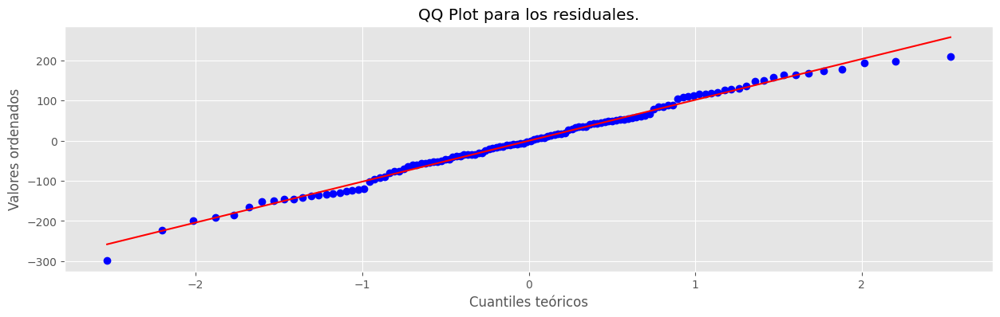

In [13]:
# QQ plot para los residuales observados. from scipy.stats import probplot
plt.figure(figsize = (15,4))
probplot(x=resid, dist="norm", plot=plt)              ## QQ-plot.
plt.xlabel("Cuantiles teóricos")
plt.ylabel("Valores ordenados")
plt.title("QQ Plot para los residuales.")
plt.show()

Como ***conclusión*** notemos que se cumplen los supuestos del modelo, pero el poder explicativo del modelo solo llega al $7.67\%$, lo cual no es un buen indicador.

## ***Regresión lineal múltiple.***

En una **regresión lineal múltiple**, el objetivo es modelar la relación entre una variable dependiente $Y$ (variable objetivo o `Target`) y múltiples variables explicativas $X_1, X_2, \ldots, X_p$, de tal manera que se pueda predecir el comportamiento de $Y$ en función de estas variables explicativas. Entonces se quiere construir una función $f(X)$ donde $X=(X_1, \ldots, X_p)$ es un conjunto de variables explicativas (`Features`) que se utilizaran para pronosticar y explicar las diferencias presentes en la variable target $Y$.


En un modelo de regresión lineal, se usan las funciones del tipo:
$$Y=\beta_0 +\beta_1X_1+\beta_2X_2+...+\beta_pX_p +\epsilon $$ 

donde $\epsilon$ se conoce como el error o ruido del modelo.

Sobre este error se realizan varios supuestos para que el modelo tenga validez estadística.
1. ***Normalidad o gaussianidad:*** Campana de Gauss
2. ***Homocedasticidad:*** La variabilidad de mi modelo no depende de las X
3. ***Independencia.***

La funcion a optimizar en este se toma la forma:

$$\text{RSS}(\beta_0, \beta_1, \dots, \beta_p) = \sum_{i=1}^{n} \left( y_i - \left( \beta_0 + \beta_1 X_{i1} + \dots + \beta_p X_{ip} \right) \right)^2
$$


Donde:
- $\text{RSS}$ es la suma de los residuos al cuadrado (**Residual Sum of Squares**).
- $y_i$ es el valor observado de la variable dependiente $Y$.
- $X_{i1}, X_{i2}, \dots, X_{ip}$ son los valores de las variables explicativas para la $i$-ésima observación.

La estimación de los coeficientes $\beta_0, \beta_1, \dots, \beta_p$ que minimizan la función de costo se puede obtener mediante la fórmula de **mínimos cuadrados ordinarios (OLS)** en su forma matricial:

$$\hat{\boldsymbol{\beta}} = \left( X^T X \right)^{-1} X^T y$$



#### ***Ejemplo 1.***


Con el objetivo de evaluar la calidad de una película utilizada en máquinas fotográficas, el  tiempo  de duración de la película,  en horas,  se relaciona con la densidad máxima de la película bajo tres condiciones experimentales: $72^{o}C$, $82^{o}C$ y $92^{o}C$. El objetivo es explicar las diferencias en el tiempo de duración de la película usando la densidad máxima  y la temperatura.

In [14]:
df2 = pd.read_excel(url_base + "chapman.xlsx")
df2.head()
df2.describe().T

,count,mean,std,min,25%,50%,75%,max
tiempo,21.0,192.000000,133.194594,24.00,96.00,144.00,288.00,504.00
densidad,21.0,2.264762,0.890020,0.65,1.49,2.27,2.91,3.55
temperatura,21.0,82.000000,8.366600,72.00,72.00,82.00,92.00,92.00


- Haga  un  gráfico  de  los  datos que  incluya  las  tres  variables  consideradas.  Comente.

In [15]:
df2["temperatura"] = df2["temperatura"].astype("object")

px.scatter(
    df2, x="densidad", y="tiempo", template="plotly_white",
    title="Densidad vs. Tiempo", trendline="ols", trendline_color_override="red"
).show()

***Respuesta***

Los plots anterior muestra que el tiempo de duración de una película disminuye a medida que la densidad máxima de la película aumenta, es decir, al parecer existe una relación lineal negativa entre el `Tiempo de duración` de la película y la `densidad máxima` de la película. Además es diferente según las tres condiciones experiementales, quizá se presenta interacción entre `densidad` y `temperatura`.

In [16]:
px.scatter(
    df2, x="densidad", y="tiempo", color="temperatura",
    template="plotly_white", title="Densidad vs. Tiempo", trendline="ols"
).show()

#### ***Ejemplo 2.***

Ajuste a los datos un modelo de regresión lineal múltiple donde la respuesta es el tiempo de duración  de  la  película  y  las  variables  explicativas  son  la  densidad  máxima, la condición experimental  y la interacción entre estas.

In [17]:
# Media de cada grupo de "temperatura" de la variable Target "tiempo".
df2.groupby("temperatura")["tiempo"].mean()

temperatura
72    288.0
82    192.0
92     96.0
Name: tiempo, dtype: float64

In [18]:
# Modelo con solo la feature categórica.
cate = smf.ols(formula="tiempo ~ temperatura", data = df2).fit()
print(cate.summary())

                            OLS Regression Results                            
Dep. Variable:                 tiempo   R-squared:                       0.364
Model:                            OLS   Adj. R-squared:                  0.293
Method:                 Least Squares   F-statistic:                     5.143
Date:                Sun, 03 Nov 2024   Prob (F-statistic):             0.0171
Time:                        20:29:22   Log-Likelihood:                -127.27
No. Observations:                  21   AIC:                             260.5
Df Residuals:                      18   BIC:                             263.7
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept           288.0000     42.33

Para este caso se observa que la diferencia de las medias es estadísticamente significativa, es decir, hay diferencias en las medias entre las categorías.

In [19]:
# Modelo SIN interacción.
model_ex2_with_inter = smf.ols(formula="tiempo ~ densidad + temperatura", data = df2).fit()
print(model_ex2_with_inter.summary())

                            OLS Regression Results                            
Dep. Variable:                 tiempo   R-squared:                       0.796
Model:                            OLS   Adj. R-squared:                  0.760
Method:                 Least Squares   F-statistic:                     22.15
Date:                Sun, 03 Nov 2024   Prob (F-statistic):           4.15e-06
Time:                        20:29:22   Log-Likelihood:                -115.31
No. Observations:                  21   AIC:                             238.6
Df Residuals:                      17   BIC:                             242.8
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept           568.0902     52.72

Con el modelo anterior se logra explicar un $79.6\%$ de las diferennias de la variable `Target` (tiempo). Note además que con este modelo obtemos una expresión de la forma:

$$tiempo=568.09-105.9228*densidad - 275.07*temperatura_{\_82}-105.9228*temperatura_{\_92}$$

En cada obtenemos una recta de regresión:

1. ***Caso 1: Corresponde a la temperatura de 72 grados:*** $tiempo=568.09-105.9228*densidad$: 
 
2. ***Caso 2: Corresponde a la temperatura de 82 grados:*** $tiempo=434.57 -105.922* densidad$

3. ***Caso 3: Corresponde a la temperatura de 92 grados:*** $tiempo=293.016 -105.922* densidad$

Estas rectas tienen la particularidad de que son rectas paralelas, es decir, no estamos teniendo en cuenta la ***interacción*** entre las dos 2 features.

***Modelado de efectos de interacción.***

Profundicemos en las interacciones potenciales observando dos de los predictores en tándem: `waterfront` y posición geográfica (`lat` and `long`). Específicamente, ¿el efecto de la posición geográfica es diferente entre las casas que tienen vista frente al mar y las que no?

In [20]:
# Modelo CON interacción.
model_ex2 = smf.ols(formula = "tiempo ~ densidad*temperatura", data = df2).fit()
print(model_ex2.summary())

                            OLS Regression Results                            
Dep. Variable:                 tiempo   R-squared:                       0.989
Model:                            OLS   Adj. R-squared:                  0.985
Method:                 Least Squares   F-statistic:                     266.3
Date:                Sun, 03 Nov 2024   Prob (F-statistic):           4.30e-14
Time:                        20:29:22   Log-Likelihood:                -84.791
No. Observations:                  21   AIC:                             181.6
Df Residuals:                      15   BIC:                             187.8
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Intercept           

#### ***Ejercicio 5.***

Interprete las estimaciones  de los parámetros excepto  el intercepto.

In [21]:
px.scatter(
    df2, x="densidad", y="tiempo", color="temperatura", 
    template="plotly_white", title="Densidad vs. Tiempo", trendline="ols"
).show()

#### ***Ejercicio 6.***

Estime  la duración esperada de una película con una densidad máxima de 2, y  una  temperatura  de  $82^{o}C$. Use el método `predict()` del modelo ajustado.

In [22]:
model_ex2.predict({"densidad":2,"temperatura":82})

0    225.253073
dtype: float64

***Comentario.***

El tiempo esperado de duración de una película bajo la condición experimental de $82^{o}C$ y con densidad máxima igual a 2 es de $225.2531$.

### ***Ejemplo 3***

In [23]:
df = pd.read_csv(url_base + "kc_house_data.csv",)
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


### ***Exploración de datos***


Comencemos por revisar las columnas del conjunto de datos y lo que significan:

1. **id**: Identificación para la casa.
2. **date**: Fecha de venta de la casa.
3. **price**: Precio al que se vendió la casa.
4. **bedrooms**: Número de habitaciones.
5. **bathrooms**: Número de baños.
6. **sqft_living**: Pies cuadrados de la casa.
7. **sqft_lot**: Pies cuadrados del lote.
8. **floors**: Total de pisos (niveles) en casa.
9. **waterfront**: Si la casa tiene o no una vista de un paseo marítimo (whether or not the house has a view of a waterfront)
10. **view**: Un índice de 0 a 4 de qué tan buena es la vista desde la propiedad
11. **condition**: Condición de la casa (que tan buena está).
12. **grade**: Calificación general otorgada a la unidad de vivienda, basada en el sistema de calificación del condado de King.
13. **sqft_above**: Metros cuadrados de la casa aparte del sótano
14. **sqft_basement**: Metros cuadrados del sótano
15. **yr_built**: Año en que se construyó la casa
16. **yr_renovated**: Año en que fué renovada la casa.
17. **zipcode**: Código postal de la casa
18. **lat**: latitude coordinate of the house
19. **long**: longitude coordinate of the house
20. **sqft_lot15** :lotSize area in 2015(implies-- some renovations)
21. **sqft_living15:** Área de la sala de estar en 2015 (implica: algunas renovaciones) Esto podría o no haber afectado el área del tamaño del lote

In [24]:
#  Vamos a formar nuestro Dataframe de trabajo
df_ml = df.drop(columns=["id", "sqft_living15", "sqft_lot15"])
df_ml.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date           21613 non-null  object 
 1   price          21613 non-null  float64
 2   bedrooms       21613 non-null  int64  
 3   bathrooms      21613 non-null  float64
 4   sqft_living    21613 non-null  int64  
 5   sqft_lot       21613 non-null  int64  
 6   floors         21613 non-null  float64
 7   waterfront     21613 non-null  int64  
 8   view           21613 non-null  int64  
 9   condition      21613 non-null  int64  
 10  grade          21613 non-null  int64  
 11  sqft_above     21613 non-null  int64  
 12  sqft_basement  21613 non-null  int64  
 13  yr_built       21613 non-null  int64  
 14  yr_renovated   21613 non-null  int64  
 15  zipcode        21613 non-null  int64  
 16  lat            21613 non-null  float64
 17  long           21613 non-null  float64
dtypes: flo

In [25]:
# "waterfront", "zipcode","view" no estan en el tipo de dato adecuado, 
df_ml[["waterfront", "zipcode", "view"]] = df_ml[["waterfront", "zipcode", "view"]].astype("category")
df_ml.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   date           21613 non-null  object  
 1   price          21613 non-null  float64 
 2   bedrooms       21613 non-null  int64   
 3   bathrooms      21613 non-null  float64 
 4   sqft_living    21613 non-null  int64   
 5   sqft_lot       21613 non-null  int64   
 6   floors         21613 non-null  float64 
 7   waterfront     21613 non-null  category
 8   view           21613 non-null  category
 9   condition      21613 non-null  int64   
 10  grade          21613 non-null  int64   
 11  sqft_above     21613 non-null  int64   
 12  sqft_basement  21613 non-null  int64   
 13  yr_built       21613 non-null  int64   
 14  yr_renovated   21613 non-null  int64   
 15  zipcode        21613 non-null  category
 16  lat            21613 non-null  float64 
 17  long           21613 non-null  

### ***Variable Target***

In [26]:
px.histogram(df_ml["price"], title="Distribucion variable objetivo", template="plotly_white")

In [27]:
# Shapiro Test.
shapiro(df_ml["price"]) 
# No hay normalidad...

ShapiroResult(statistic=0.7120112962695346, pvalue=8.944594546946854e-104)

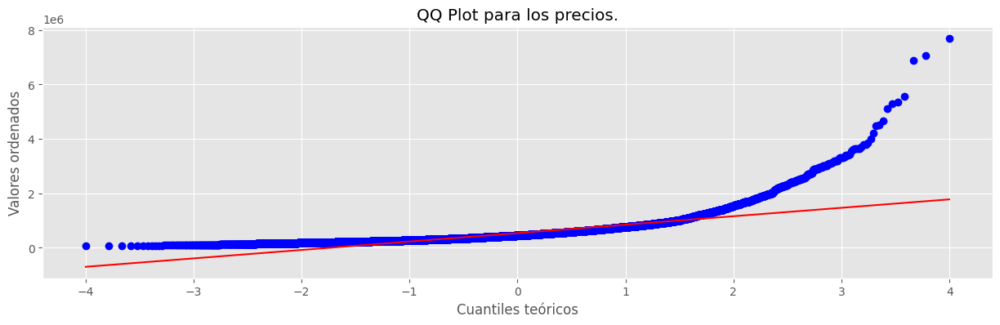

In [28]:
# QQ plot de la variable Target ----> "price"
plt.figure(figsize = (15,4))
probplot(x=df_ml["price"], dist="norm", plot=plt)
plt.xlabel("Cuantiles teóricos")
plt.ylabel("Valores ordenados")
plt.title("QQ Plot para los precios.")
plt.show()

Notemos que la distribución se aleja bastante de la distribución normal. El algunos casos podemos buscar normalizar la variable Target. Recuerde que puede usar la transformación de [Box-Cox](https://en.wikipedia.org/wiki/Box%E2%80%93Cox_distribution)

In [29]:
# Note que podemos hacer uso de la siguiente transformación: (Coincide con Box-Cox!!!)
px.histogram(x=np.log(df_ml["price"]), title="Logaritmo natural de la variable price, log(price)", template="plotly_white")

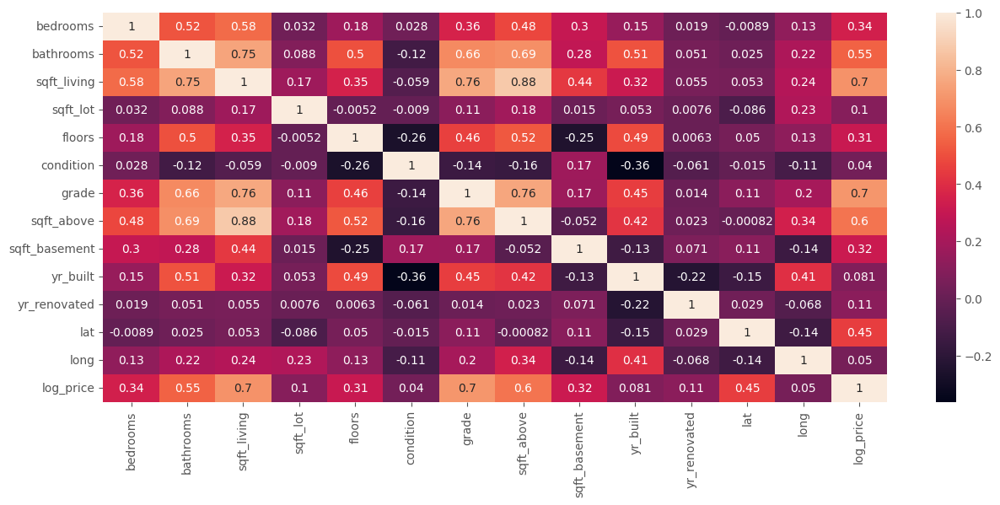

In [30]:
# Transformamos la varible target, log(price)
df_ml["log_price"] = np.log(df_ml["price"])

# Veamos las correlaciones.
sns.heatmap(df_ml.drop(columns=["price"]).select_dtypes(np.number).corr(), annot=True)
plt.show()

In [31]:
# Tomemos un umbral pues tenemos bastantes variables
higt_corr = df_ml.drop(columns=["price"]).select_dtypes(np.number).corr().loc["log_price"]
higt_corr.sort_values(ascending=False)

log_price        1.000000
grade            0.703634
sqft_living      0.695341
sqft_above       0.601801
bathrooms        0.550802
lat              0.449174
bedrooms         0.343561
sqft_basement    0.316970
floors           0.310558
yr_renovated     0.114498
sqft_lot         0.099622
yr_built         0.080655
long             0.049942
condition        0.039558
Name: log_price, dtype: float64

In [32]:
# Exploración con una de las más altamente relacionada
px.scatter(
    df_ml,  x="sqft_living", y="log_price", title="Sqft_living vs. Precio",
    trendline="ols", trendline_color_override="red", template="plotly_white"
).update_traces(marker=dict(size=3))

In [33]:
df_temp = df_ml[["log_price", "sqft_living"]]
df_temp["log_sqft_living"] = np.log(df_temp["sqft_living"])


px.scatter(
    df_temp,  x="log_sqft_living", y="log_price", title="Sqft_living vs. Precio (log-log)",
    trendline="ols", trendline_color_override="red", template="plotly_white"
).update_traces(marker=dict(size=3))

### ***Modelo Log-Log.***


El primer modelo de inspección es:

$$
\log(price) = \beta_0 + \beta_1 \log(sqft{\_}living) + \varepsilon
$$

In [34]:
formula = "log_price~log_sqft_living"
log_log_model = smf.ols(formula, data=df_temp).fit()
print(log_log_model.summary())

                            OLS Regression Results                            
Dep. Variable:              log_price   R-squared:                       0.456
Model:                            OLS   Adj. R-squared:                  0.455
Method:                 Least Squares   F-statistic:                 1.808e+04
Date:                Sun, 03 Nov 2024   Prob (F-statistic):               0.00
Time:                        20:29:24   Log-Likelihood:                -10240.
No. Observations:               21613   AIC:                         2.048e+04
Df Residuals:                   21611   BIC:                         2.050e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
Intercept           6.7299      0.047    1

Tenemos que ser conscientes de cómo interpretamos los coeficientes aquí. En una regresión en la que tanto la variable independiente como la dependiente son transformaciones logarítmicas (una *log-log regression*), el coeficiente $\beta_1$ debe interpretarse como el *cambio porcentual* en la variable dependiente asociada con el 1\% de cambio en la variable independiente. Esta comparación de cambio de porcentaje frente a porcentaje se conoce como **elasticidad**. Así, en nuestro modelo:

---

***Un aumento del 1\% en la superficie habitable se asocia con un aumento del 0,8368\% en el precio.***



---

### ***Modelo Log-Level***

Ahora construyamos un modelo lineal donde la transformación logarítmica solo se aplica a los precios de la vivienda, es decir, un modelo de la forma:
$$
\log(price) = \beta_0 + \beta_1 sqft{\_}living + \varepsilon
$$

El plot y la tabla de salida están a continuación:

In [35]:
log_log_model = smf.ols("log_price ~ sqft_living", data=df_ml).fit()
print(log_log_model.summary())

                            OLS Regression Results                            
Dep. Variable:              log_price   R-squared:                       0.483
Model:                            OLS   Adj. R-squared:                  0.483
Method:                 Least Squares   F-statistic:                 2.023e+04
Date:                Sun, 03 Nov 2024   Prob (F-statistic):               0.00
Time:                        20:29:24   Log-Likelihood:                -9670.2
No. Observations:               21613   AIC:                         1.934e+04
Df Residuals:                   21611   BIC:                         1.936e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept      12.2185      0.006   1916.883      

La interpretación del coeficiente de regresión vuelve a ser diferente. Esta es una *log-level regression*; es decir, uno en el que la variable dependiente se ha transformado logarítmicamente y la variable independiente no. Interpretamos el coeficiente como una **semi-elasticidad**, donde un aumento absoluto en `sqft_living` (porque no se le ha aplicado la función logarítmica) corresponde a un aumento porcentual en `price`. Específicamente, aquí podemos decir que:

---

***Un aumento en el espacio habitable de 1 pie cuadrado conduce a un aumento del 0,04 % en el precio.***

---

***Podemos ver en estos gráficos que los puntos de datos del modelo log-log se agrupan más uniformemente alrededor de la línea de mejor ajuste en diferentes niveles de la variable independiente en comparación con el otro modelo, lo que sugiere que el modelo log-log es más lineal.***

### ***Corriendo regresiones con variables transformadas.***

Por supuesto, no tiene sentido limitarnos a modelar los precios de la vivienda usando solo una variable independiente. Agreguemos varias variables más, algunas transformadas y otras no.

¿En el contexto del problema que otras features considera importantes?. Podemos pensar en:

1. ***`zipcode` (Ubicación del predio ).***
2. ***`waterfroont` (Cercania al mar).***
3. ***`view` (Vista del predio)***

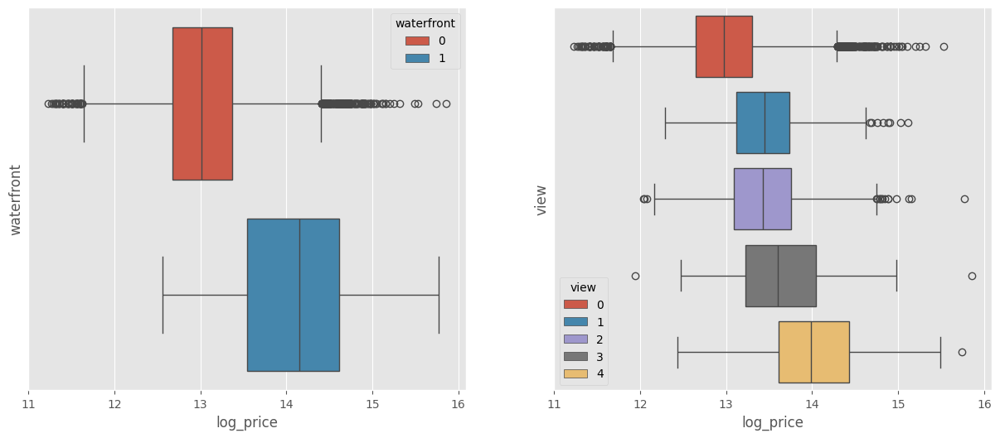

In [36]:
# Sirven para discriminar??
fig, ax = plt.subplots(1,2)
sns.boxplot(data=df_ml, x="log_price", y="waterfront", ax=ax[0], hue="waterfront")
sns.boxplot(data=df_ml, x="log_price", y="view", ax=ax[1], hue="view")
ax[0].set_yticks([])
ax[0].set_yticklabels([])
ax[1].set_yticks([])
ax[1].set_yticklabels([])
plt.show()

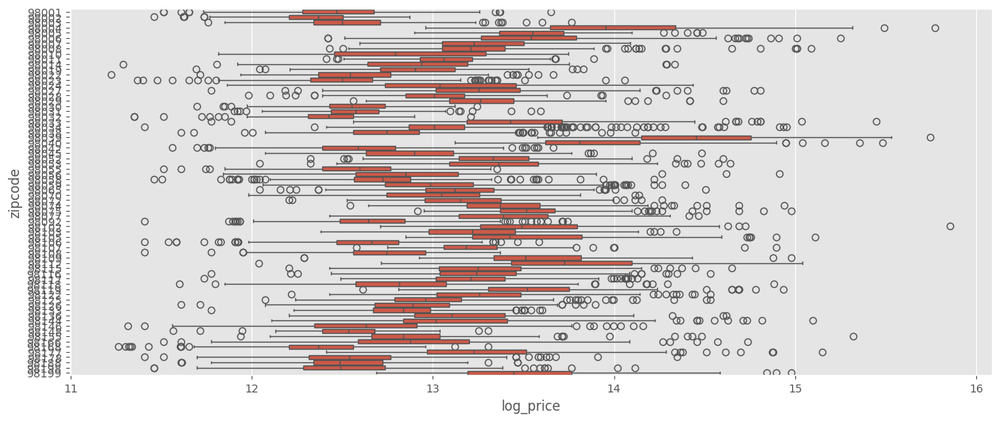

In [37]:
sns.boxplot(data=df_ml, x="log_price", y="zipcode")
plt.show()

***Vamos a incorporarlas al modelo.***

Hasta este momento hemos tenido en cuenta las siguientes features para incluir en el modelo:

1. `log_sqft_living` (sqft_living).
2. `zipcode`.
3. `view`
4. `waterfront`
5. `grade`.
6. `sqft_above`

#### ***Contextualizacion geografica.***

In [38]:
# Contextualizacion Geografica.
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", colors=["yellow", "red"], N=9)

map = folium.Map(
    location=[df_ml["lat"].mean(), df_ml["long"].mean()],
    zoom_start=9,
    min_zoom=4
)

title_html = """
<h2 align="center" style="font-size:25px"><b>Color Map</b></h2>
"""
map.get_root().html.add_child(folium.Element(title_html))

color_scale = folium.LinearColormap(
    colors=[mcolors.rgb2hex(cmap(i)) for i in range(9)],
    vmin=df_ml["price"].quantile(0.01), vmax=df_ml["price"].quantile(0.99)
)

for index, row in df_ml.iterrows():
    folium.CircleMarker(
        location=[row["lat"], row["long"]],
        radius=0.001,
        color=color_scale(row["price"]),
        fill=True,
        fill_color=color_scale(row["price"]),        
        popup=f"price: ${int(row['price'])}"
    ).add_to(map)

color_scale.add_to(map)
map

In [39]:
# Veamos el comportamiento de "lat"
(
    px.scatter(
        df_ml,  x="lat", y="log_price", trendline="ols",
        trendline_color_override="red",
        template="plotly_white"
    )
    .update_traces(marker=dict(size=2, color="blue"))
    .show()
)

Note que existe cierta relación lineal entre la variable `Target` y `lat`, además, puede observar lo siguiente:

In [40]:
(
    px.scatter(
        df_ml,  x="lat", y="log_price", trendline="ols",
        template="plotly_white", color="waterfront"
    )
    .update_traces(marker=dict(size=2.5))
    .show()
)

***El plot anterior sugiere que podemos ingresar `lat` además del efecto de la interacción***

In [41]:
# Consideremos variables que no estén incluidas
temp = pd.DataFrame(
    {
        "log_sqft_lot": np.log(df_ml["sqft_lot"]),
        "log_price": df_ml["log_price"]
    }
)

px.scatter(
    temp, x="log_sqft_lot", y="log_price", trendline="ols",
    trendline_color_override="red",
    template="plotly_white"
).update_traces(marker=dict(size=1.8, color="blue")).show()


In [42]:
df_ml["renovated"] = df_ml["yr_renovated"] > 0 

formula_ref = """
                np.log(price) ~ np.log(sqft_living)*C(renovated) + np.log(sqft_lot)
                + bedrooms + floors + bathrooms + condition + C(view) + grade + yr_built
                + lat*C(waterfront) + I(lat**2) + long + C(zipcode)
              """
model_ref = smf.ols(formula=formula_ref, data=df_ml).fit()
print(model_ref.summary())

                            OLS Regression Results                            
Dep. Variable:          np.log(price)   R-squared:                       0.880
Model:                            OLS   Adj. R-squared:                  0.880
Method:                 Least Squares   F-statistic:                     1795.
Date:                Sun, 03 Nov 2024   Prob (F-statistic):               0.00
Time:                        20:29:56   Log-Likelihood:                 6111.7
No. Observations:               21613   AIC:                        -1.205e+04
Df Residuals:                   21524   BIC:                        -1.134e+04
Df Model:                          88                                         
Covariance Type:            nonrobust                                         
                                               coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------

## ***Train-Test sets***

In [43]:
df_kc = pd.read_csv(url_base + "kc_house_data.csv")
df_kc = df_kc.set_index("id")

df_kc["renovated"] = df_kc["yr_renovated"].apply(lambda x: 1 if x>0 else 0)
df_kc["log_price"] = np.log(df_kc["price"])
df_kc[["waterfront", "zipcode", "view"]] = df_kc[["waterfront", "zipcode", "view"]].astype("object")
df_kc = df_kc.drop(columns=["sqft_living15", "sqft_lot15", "date", "yr_renovated", "price"])
df_kc.head()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,zipcode,lat,long,renovated,log_price
id,,,,,,,,,,,,,,,,,
7129300520,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,98178,47.5112,-122.257,0,12.309982
6414100192,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,98125,47.7210,-122.319,1,13.195614
5631500400,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,98028,47.7379,-122.233,0,12.100712
2487200875,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,98136,47.5208,-122.393,0,13.311329
1954400510,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,98074,47.6168,-122.045,0,13.142166


In [44]:
X = pd.get_dummies(df_kc, drop_first=True).drop(columns=["log_price"])
y = df_kc["log_price"]
display(X.head())
display(y.head())

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,condition,grade,sqft_above,sqft_basement,yr_built,...,zipcode_98146,zipcode_98148,zipcode_98155,zipcode_98166,zipcode_98168,zipcode_98177,zipcode_98178,zipcode_98188,zipcode_98198,zipcode_98199
id,,,,,,,,,,,,,,,,,,,,,
7129300520,3,1.00,1180,5650,1.0,3,7,1180,0,1955,...,False,False,False,False,False,False,True,False,False,False
6414100192,3,2.25,2570,7242,2.0,3,7,2170,400,1951,...,False,False,False,False,False,False,False,False,False,False
5631500400,2,1.00,770,10000,1.0,3,6,770,0,1933,...,False,False,False,False,False,False,False,False,False,False
2487200875,4,3.00,1960,5000,1.0,5,7,1050,910,1965,...,False,False,False,False,False,False,False,False,False,False
1954400510,3,2.00,1680,8080,1.0,3,8,1680,0,1987,...,False,False,False,False,False,False,False,False,False,False


id
7129300520    12.309982
6414100192    13.195614
5631500400    12.100712
2487200875    13.311329
1954400510    13.142166
Name: log_price, dtype: float64

In [45]:
# Con sklearn
# encoder = OneHotEncoder(drop="first", sparse_output=False)
# X_categorical_encoded = encoder.fit_transform(df_kc.select_dtypes("object"))
# pd.DataFrame(X_categorical_encoded)

In [46]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
X_train

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,condition,grade,sqft_above,sqft_basement,yr_built,...,zipcode_98146,zipcode_98148,zipcode_98155,zipcode_98166,zipcode_98168,zipcode_98177,zipcode_98178,zipcode_98188,zipcode_98198,zipcode_98199
id,,,,,,,,,,,,,,,,,,,,,
4045500510,1,1.00,960,40946,1.0,5,5,960,0,1945,...,False,False,False,False,False,False,False,False,False,False
3824100020,3,1.75,1510,9720,1.0,3,7,1510,0,1948,...,False,False,False,False,False,False,False,False,False,False
6383000690,3,2.25,1670,6414,1.0,4,8,1670,0,1961,...,False,False,False,False,False,False,False,False,False,False
2320069014,3,2.00,2660,192099,1.0,4,9,2660,0,1964,...,False,False,False,False,False,False,False,False,False,False
5315101716,3,1.75,1690,13500,1.0,4,7,1690,0,1978,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2322069010,5,5.00,3960,94089,2.0,3,10,3960,0,1998,...,False,False,False,False,False,False,False,False,False,False
2114700368,2,2.50,1400,1262,2.0,3,8,1160,240,2008,...,False,False,False,False,False,False,False,False,False,False
5469501200,3,2.25,2360,14950,1.0,4,9,2360,0,1978,...,False,False,False,False,False,False,False,False,False,False


In [47]:
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)

LinearRegression()

In [48]:
pd.DataFrame(linear_model.coef_, index=X_train.columns, columns=["betas"]).T

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,condition,grade,sqft_above,sqft_basement,yr_built,...,zipcode_98146,zipcode_98148,zipcode_98155,zipcode_98166,zipcode_98168,zipcode_98177,zipcode_98178,zipcode_98188,zipcode_98198,zipcode_98199
betas,0.004541,0.038941,-4.817226e+06,6.605838e-07,-0.037367,0.054626,0.104201,4.817226e+06,4.817226e+06,-0.000495,...,0.107353,0.059306,0.17174,0.191876,-0.047642,0.335127,0.06019,0.000487,-0.004766,0.624563


In [49]:
print(f"Score en train : {linear_model.score(X_train, y_train):.3f}")
print(f"Score en test :  {linear_model.score(X_test, y_test):.3f}")

Score en train : 0.875
Score en test :  0.872


### ***Evaluación del rendimiento predictivo***

Para cualquier Dataset, los residuales proporcionan la diferencia entre la predicción del modelo para ese registro y el valor real de ese punto.

El **error absoluto medio (MAE)** es una métrica que resume el rendimiento holístico (del todo) del modelo en toda la data. El MAE se calcula tomando el valor absoluto de cada residuo y luego tomando la media de todos esos valores absolutos. En esencia, el MAE describe la magnitud típica de los residuales; cuanto menor sea el MAE, mejor.

$$MAE = \frac{1}{n} \sum_{i=1}^n \left| y_i - \hat{y}_i \right|$$

El **error cuadrático medio (RMSE)** se calcula tomando el cuadrado de cada residuo, promediando y luego sacando la raíz cuadrada.

$$RMSE = \sqrt{ \frac{1}{n} \sum_{i=1}^n ( y_i - \hat{y}_i )^2 }$$

Aunque `RMSE` puede parecer innecesariamente complicado en comparación con MAE, se usa mucho más comúnmente. La razón es que la métrica `RMSE` es la misma que se minimiza en los datos de entrenamiento mediante un modelo de regresión lineal estándar (también llamado regresión de **mínimos cuadrados ordinarios (OLS)**). Esto lo convierte en una opción "natural" que utiliza la misma métrica para evaluar el rendimiento fuera de la muestra (`test`). Considere lo siguiente:

El `RMSE` pone mucho más peso en los valores atípicos, ya que los errores se elevan al cuadrado antes de promediarlos. En los casos en que los valores atípicos son especialmente malos y deben castigarse, el RMSE es una mejor opción.

Finalmente, está el **error porcentual absoluto medio** (MAPE). Esto toma el valor absoluto de cada residual y lo divide por el valor real de ese punto para obtener un porcentaje, luego promediando todos los porcentajes.

$$MAPE = 100\% \frac{1}{n} \sum_{i=1}^n \left|\frac{ y_i - \hat{y}_i}{y_i} \right|$$

El `MAPE` tiene una buena interpretación en la que podemos decir que las predicciones de un modelo son, en promedio, incorrectas en un cierto porcentaje. 

In [50]:
# True
y_price_train = np.exp(y_train)
y_price_test = np.exp(y_test)

# Predict
y_price_train_predict = np.exp(linear_model.predict(X_train))
y_price_test_predict = np.exp(linear_model.predict(X_test))

In [51]:
print(f"TRAIN R^2: {r2_score(y_price_train, y_price_train_predict):.4f}")
print(f"TEST R^2:  {r2_score(y_price_test, y_price_test_predict):.4f}\n")

print(f"TRAIN MAE: {mean_absolute_error(y_price_train, y_price_train_predict):.4f}")
print(f"TEST MAE:  {mean_absolute_error(y_price_test, y_price_test_predict):.4f}\n")

print(f"TRAIN MAPE: {100*mean_absolute_percentage_error(y_price_train, y_price_train_predict):.4f}")
print(f"TEST MAPE:  {100*mean_absolute_percentage_error(y_price_test, y_price_test_predict):.4f}")

TRAIN R^2: 0.7184
TEST R^2:  0.7531

TRAIN MAE: 78411.9833
TEST MAE:  76827.7024

TRAIN MAPE: 14.1077
TEST MAPE:  14.0674


In [52]:
df_plot = pd.DataFrame({"valor_verdadero": y_price_train, "valor_predicho": y_price_train_predict})
px.scatter(df_plot, x="valor_verdadero", y="valor_predicho", template="plotly_white")

In [53]:
df_plot = pd.DataFrame({"valor_verdadero": y_price_test, "valor_predicho": y_price_test_predict})
px.scatter(df_plot, x="valor_verdadero", y="valor_predicho", template="plotly_white")

In [54]:
df_review = pd.DataFrame(
    {"price": np.exp(y_train), "predict": np.exp(linear_model.predict(X_train))},
    index=X_train.index
)

df_review["estimator_diff"] = abs(df_review["price"] - df_review["predict"])
df_review = df_review.sort_values(by=["estimator_diff"], ascending=False).head(100)
df_review = df_kc.merge(df_review, left_index=True, right_index=True)

map = folium.Map(location=[df_kc["lat"].mean(), df_kc["long"].mean()], zoom_start=10, min_zoom=4)

title_html = """
<h2 align="center" style="font-size:20px"><br><b>Mayores diferencia Precios y Predicciones</b></h2>
"""
map.get_root().html.add_child(folium.Element(title_html))

for index, row in df_review.iterrows():
    popup_text = f"""
    <b>Price:</b> ${int(row['price']):,}<br>
    <b>Predicted:</b> ${row['predict']:,.0f}<br>
    <b>Difference:</b> ${row['estimator_diff']:,.0f}
    <b>Id:</b> {index}
    """
    marker = folium.Marker(
        location=[row["lat"], row["long"]],
        popup=popup_text,
    )
    icon = folium.Icon(icon="home", prefix="fa", color="green", icon_size=(40, 60))
    marker.add_child(icon)
    marker.add_to(map)
 
map

### ***Referencias***

1. "House Sales in King County, USA", August 25, 2016, harlfoxem, CC0 Public Domain, https://www.kaggle.com/harlfoxem/housesalesprediction

2. _R. E. Chapman, Degradation Study of a Photographic Developer to Determine Shelf Life, Quality Engineering 10 (1997), pp. 137 – 140._`